In [1]:
%matplotlib notebook

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl

import time
import pickle

import memory_profiler

%load_ext memory_profiler

from pathlib import Path

In [2]:
import nltk
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet
from nltk import pos_tag, word_tokenize

# Download necessary NLTK data
nltk.download("averaged_perceptron_tagger")
nltk.download("wordnet")
nltk.download("punkt")

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/sdoneva/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to /Users/sdoneva/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to /Users/sdoneva/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [3]:
import black
import jupyter_black

jupyter_black.load(line_length=79)

In [4]:
%load_ext autoreload
%autoreload 2

import src
from src.plotting import (
    automatic_coloring,
    improved_coloring,
    years_coloring,
    plot_tsne_colors,
    plot_label_tags,
    plot_tsne_years,
)

In [18]:
variables_path = Path("./data/variables")
figures_path = Path("./viz/embeddings")
embeddings_data_path = Path("data/embeddings/")

In [19]:
plt.style.use("matplotlib_style.txt")

# Colors

## Import data

In [202]:
df = pd.read_csv(
    "data/annotated_aact/snomed_linking_outputs/combined_union_annotations_with_details_18609.csv"
)

In [203]:
df.head()

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,start_year
0,89,NCT00000307,Naltrexone (substance),Disorder caused by alcohol (disorder)|Disorder...,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,2003-04-30,Naltrexone as an Adjunct in Alcoholic Cocaine ...,The purpose of this study is to evaluate naltr...,2003.0
1,106,NCT00000333,Atropine (substance)|Benzatropine (substance)|...,Cocaine|Disorder caused by cocaine (disorder),Evaluation of Benztropine for Cocaine Craving - 2,2001-05-31,Evaluation of Efficacy of Benztropine for Coca...,The purpose of this study is to compare the ef...,2001.0
2,145,NCT00000428,Amitriptyline (substance)|Fluoxetine (substanc...,Fibromyalgia (disorder),Combining N-of-1 Trials to Assess Fibromyalgia...,2000-09-30,Combining N-of-1 Trials to Assess Fibromyalgia...,This study will compare the effectiveness of c...,2000.0
3,146,NCT00000439,Sodium valproate (substance)|Valproate (substa...,Bipolar disorder (disorder)|Disorder caused by...,Drug Treatment for Alcoholics With Bipolar Dis...,2000-10-31,Efficacy of Valproate Maintenance in Bipolar A...,The purpose of this study is to test the effec...,2000.0
4,220,NCT00001956,Ketorolac (substance)|Lidocaine (substance)|Mi...,Central pain syndrome (disorder)|Disorder of m...,Influence of Genetics in Pain Sensitivity,2000-01-31,NaN,The purpose of this study is to learn more abo...,2000.0


In [204]:
df[df["nct_id"] == "NCT05166161"]

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,start_year
16719,17395,NCT05166161,Coagulation factor IX (substance)|Sepiapterin ...,Hyperphenylalaninemia (disorder)|Phenylketonur...,A Long-Term Safety Study of PTC923 in Particip...,2022-02-14,A Phase 3 Open-Label Study of PTC923 (Sepiapte...,The main purpose of this study is to evaluate ...,2022.0


In [205]:
intervention_col = "combined_union_snomed_term_canonical_interventions"
conditions_col = "combined_union_top_concept_canonical_first_conditions"

In [206]:
df["trial_title_summary"] = (
    df["brief_title"].fillna("")
    + " | "
    + df["study_official_title"].fillna("")
    + " | "
    + df["brief_summary_description"].fillna("")
    + " | "
    + df[intervention_col].fillna("")
)

In [207]:
df.shape

(18609, 10)

### load tsne

In [208]:
tsne_reparsed = np.load(variables_path / "tsne_reparsed.npy")

In [209]:
tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

In [210]:
tsne.shape

(18609, 2)

## Preprocess

In [211]:
# Function to lemmatize a sentence
def lemmatize_sentence(sentence):
    lemmatizer = WordNetLemmatizer()
    # Tokenize the sentence
    tokens = word_tokenize(sentence)
    # Lemmatize each token with its correct POS tag
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]
    # Combine the lemmatized tokens back into a single string
    return " ".join(lemmatized_tokens)

In [212]:
# df["lemmatized_trial_title_summary"] = df["trial_title_summary"].apply(
#    lambda x: lemmatize_sentence(x)
# )

In [213]:
df.head()

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,start_year,trial_title_summary
0,89,NCT00000307,Naltrexone (substance),Disorder caused by alcohol (disorder)|Disorder...,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,2003-04-30,Naltrexone as an Adjunct in Alcoholic Cocaine ...,The purpose of this study is to evaluate naltr...,2003.0,Naltrexone as Adjunct in Alcoholic Cocaine Dep...
1,106,NCT00000333,Atropine (substance)|Benzatropine (substance)|...,Cocaine|Disorder caused by cocaine (disorder),Evaluation of Benztropine for Cocaine Craving - 2,2001-05-31,Evaluation of Efficacy of Benztropine for Coca...,The purpose of this study is to compare the ef...,2001.0,Evaluation of Benztropine for Cocaine Craving ...
2,145,NCT00000428,Amitriptyline (substance)|Fluoxetine (substanc...,Fibromyalgia (disorder),Combining N-of-1 Trials to Assess Fibromyalgia...,2000-09-30,Combining N-of-1 Trials to Assess Fibromyalgia...,This study will compare the effectiveness of c...,2000.0,Combining N-of-1 Trials to Assess Fibromyalgia...
3,146,NCT00000439,Sodium valproate (substance)|Valproate (substa...,Bipolar disorder (disorder)|Disorder caused by...,Drug Treatment for Alcoholics With Bipolar Dis...,2000-10-31,Efficacy of Valproate Maintenance in Bipolar A...,The purpose of this study is to test the effec...,2000.0,Drug Treatment for Alcoholics With Bipolar Dis...
4,220,NCT00001956,Ketorolac (substance)|Lidocaine (substance)|Mi...,Central pain syndrome (disorder)|Disorder of m...,Influence of Genetics in Pain Sensitivity,2000-01-31,NaN,The purpose of this study is to learn more abo...,2000.0,Influence of Genetics in Pain Sensitivity | |...


In [214]:
# df.to_csv("df_with_lemma.csv")

## Colors based on keywords

### Conditions

In [215]:
"""
Description of colors and words below.

Colors:
-chosen_colors: colors chosen manually from Scanpy colors selection 
(originally from http://godsnotwheregodsnot.blogspot.com/2013/11/kmeans-color-quantization-seeding.html)

Words:
-words_capital: Words selected manually from the 100 most relevant words using threshold 0.1.
"""

# COLORS
chosen_colors = [
    "black",
    "#aeaa00",
    "#1CE6FF",
    "#FF34FF",
    "#FF4A46",
    "#008941",
    "#006FA6",
    "#0089A3",
    "#0000A6",
    "#B79762",
    "#004D43",
    "#8FB0FF",
    "#5A0007",
    "#BA0900",
    "#1B4400",
    "#4FC601",
    "#3B5DFF",
    "#00C2A0",
    "#549E79",
    "#BC23FF",
    "#C895C5",
    "#FF2F80",
    "#009271",
    "#00FECF",
    "#A4E804",
    "#FFB500",
    "#6B002C",
    "#FF9408",
    "#CC0744",
    "#D790FF",
    "#5B4534",
    "#E83000",
    "#6F0062",
    "#b65141",
    "#C20078",
    "#7A4900",
    "#FF90C9",
    "#6508ba",
]
# WORDS
words = [
    "dystrophy",
    "cocaine",
    "stroke",
    "delirium",
    "cancer",
    "sleep",
    "tumor",
    "opioid",
    "ataxia",
    "pharmacokinetic",
    "fibromyalgia",
    "fabry disease",
    "dementia",
    "withdrawal",
    "tourette",
    "autism",
    "vaccine",
    "dependence",
    "spinal",
    "erectile dysfunction",
    "seizures",
    "lateral sclerosis",
    "diabetes",
    "smoking",
    "anxiety",
    "epilepsy",
    "OCD",
    "migraine",
    "stress",
    "neonatal",
    "bipolar",
    "hemorrhage",
    "multiple sclerosis",
    "depression",
    "alzheimer",
    "pain",
    "parkinson",
    "schizophrenia",
]

In [216]:
nsc_words = [
    "plasticity",
    "visual",
    "auditory",
    "parkinson",
    "learning",
    "memory",
    "sleep",
    "depression",
    "cognitive",
    "olfactory",
    "alzheimer",
    "social",
    "pain",
    "attention",
    "prefrontal",
    "temporal",
    "schizophrenia",
    "retina",
    "stress",
    "sensory",
    "cerebellar",
    "hippocampus",
    "motor",
    "perception",
    "age",
    "behavioral",
    "stroke",
    "epilepsy",
    "reward",
    "imaging",
    "fear",
    "astrocytes",
    "sclerosis",
    "dependence",
    "migraine",
    "tumor",
    "bipolar",
    "pharmacokinetic",
]

In [218]:
top_30_disease_names = [
    "Depressive disorder",
    "Schizophrenia",
    "Alzheimer's disease",
    "Parkinsonism",
    "Neoplastic disease",
    "Anxiety disorder",
    "Multiple sclerosis",
    "Seizure disorder",
    "Cognitive disorder",
    "Pain",
    "Cerebrovascular accident",
    "Headache disorder",
    "Infectious disease",
    "Congenital malformation",
    "Bipolar disorder",
    "Sleep disorder",
    "Psychotic disorder",
    "Spinal cord disorder",
    "Psychoactive substance abuse",
    "Infectious disease",
    "Sexual disorder",
    "Neoplasm of nervous system",
    "Developmental mental disorder",
    "Motor neuron disease",
    "Peripheral nerve disease",
    "Traumatic brain injury",
    "Confusional state",
    "Schizoaffective disorder",
    "Cranial neuralgia",
    "Bodily distress disorder",
    "Disorder caused by cocaine",
]

In [219]:
len(nsc_words), len(words)

(38, 38)

In [220]:
df["trial_title_summary"] = df["trial_title_summary"].str.replace(
    r"\bsmoker(s)?\b", "smoking", case=False, regex=True
)
df["trial_title_summary"] = df["trial_title_summary"].str.replace(
    r"\bdepressive\b", "depression", case=False, regex=True
)
df["trial_title_summary"] = df["trial_title_summary"].str.replace(
    r"\bopiate\b", "opioid", case=False, regex=True
)
df["trial_title_summary"] = df["trial_title_summary"].str.replace(
    r"\binsomnia\b", "sleep disorder", case=False, regex=True
)
df["trial_title_summary"] = df["trial_title_summary"].str.replace(
    r"\bschizophrenic\b", "schizophrenia", case=False, regex=True
)
df["trial_title_summary"] = df["trial_title_summary"].str.replace(
    r"\bvaccines\b", "vaccine", case=False, regex=True
)

In [221]:
len(chosen_colors), len(words)

(38, 38)

In [222]:
colors_new_legend = dict(zip(top_30_disease_names, chosen_colors))
len(colors_new_legend)

30

#### assign cluster

In [223]:
df.head()

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,start_year,trial_title_summary
0,89,NCT00000307,Naltrexone (substance),Disorder caused by alcohol (disorder)|Disorder...,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,2003-04-30,Naltrexone as an Adjunct in Alcoholic Cocaine ...,The purpose of this study is to evaluate naltr...,2003.0,Naltrexone as Adjunct in Alcoholic Cocaine Dep...
1,106,NCT00000333,Atropine (substance)|Benzatropine (substance)|...,Cocaine|Disorder caused by cocaine (disorder),Evaluation of Benztropine for Cocaine Craving - 2,2001-05-31,Evaluation of Efficacy of Benztropine for Coca...,The purpose of this study is to compare the ef...,2001.0,Evaluation of Benztropine for Cocaine Craving ...
2,145,NCT00000428,Amitriptyline (substance)|Fluoxetine (substanc...,Fibromyalgia (disorder),Combining N-of-1 Trials to Assess Fibromyalgia...,2000-09-30,Combining N-of-1 Trials to Assess Fibromyalgia...,This study will compare the effectiveness of c...,2000.0,Combining N-of-1 Trials to Assess Fibromyalgia...
3,146,NCT00000439,Sodium valproate (substance)|Valproate (substa...,Bipolar disorder (disorder)|Disorder caused by...,Drug Treatment for Alcoholics With Bipolar Dis...,2000-10-31,Efficacy of Valproate Maintenance in Bipolar A...,The purpose of this study is to test the effec...,2000.0,Drug Treatment for Alcoholics With Bipolar Dis...
4,220,NCT00001956,Ketorolac (substance)|Lidocaine (substance)|Mi...,Central pain syndrome (disorder)|Disorder of m...,Influence of Genetics in Pain Sensitivity,2000-01-31,NaN,The purpose of this study is to learn more abo...,2000.0,Influence of Genetics in Pain Sensitivity | |...


In [224]:
%%time
labels_new, colors_new = improved_coloring(
    df["combined_union_top_concept_canonical_first_conditions"],
    colors_new_legend,
)

df["cluster"] = labels_new

CPU times: user 253 ms, sys: 6.65 ms, total: 260 ms
Wall time: 260 ms


In [225]:
cluster_sizes = df["cluster"].value_counts()

# Optionally, to convert it back to a DataFrame for better visualization or further processing:
cluster_sizes_df = cluster_sizes.reset_index().rename(
    columns={"index": "Cluster", "cluster": "Size"}
)

print(cluster_sizes_df)

                             Size  count
0                       unlabeled   3603
1                    Parkinsonism    942
2                   Schizophrenia    869
3              Infectious disease    776
4             Alzheimer's disease    733
5              Multiple sclerosis    722
6                Seizure disorder    688
7        Cerebrovascular accident    687
8             Depressive disorder    666
9              Cognitive disorder    663
10              Headache disorder    636
11        Congenital malformation    573
12               Anxiety disorder    570
13               Bipolar disorder    548
14                 Sleep disorder    547
15   Psychoactive substance abuse    469
16           Spinal cord disorder    428
17                Sexual disorder    383
18                           Pain    378
19           Motor neuron disease    359
20     Neoplasm of nervous system    358
21  Developmental mental disorder    350
22              Confusional state    341
23              

In [226]:
df_no_cluster = df[df["cluster"] == "unlabeled"]
df_no_cluster.shape

(3603, 11)

In [227]:
counts = df_no_cluster[conditions_col].value_counts()
counts = counts.sort_values(ascending=False).head(30)

In [228]:
counts

combined_union_top_concept_canonical_first_conditions
Fibromyalgia (disorder)                                                                                                        72
Obsessive-compulsive disorder (disorder)                                                                                       69
Behavioral syndrome associated with physiological disturbance and physical factors (disorder)                                  62
Chronic mental disorder (disorder)|Dystonia (disorder)                                                                         60
Respiratory obstruction (disorder)|Sleep apnea (disorder)                                                                      59
Hereditary disorder of nervous system (disorder)|Hereditary metabolic disease (disorder)                                       59
Hyperphenylalaninemia (disorder)|Phenylketonuria (disorder)                                                                    54
Acromegaly (disorder)               

In [229]:
df_no_cluster.to_csv("missing_cluster_nsc_words.csv")

In [230]:
len(labels_new)

18609

In [231]:
# save results
np.save(variables_path / "colors_new", colors_new)

# save results
f = open(variables_path / "colors_new_legend.pkl", "wb")
pickle.dump(colors_new_legend, f)
f.close()

#### Plot

In [232]:
tsne

array([[ -21.18816944, -103.92691703],
       [ -20.67828479, -107.76614901],
       [  28.74919631,    6.97977126],
       ...,
       [ 102.47873762,  -38.68232043],
       [ -51.45323918,   -5.53557193],
       [ 106.6287184 ,  -18.45985532]])

In [233]:
# load
# legend colors
pickle_in = open(variables_path / "colors_new_legend.pkl", "rb")
colors_new_legend = pickle.load(pickle_in)

colors_new = np.load(variables_path / "colors_new.npy", allow_pickle=True)

In [234]:
len(colors_new)

18609

In [235]:
len(tsne)

18609

/Users/sdoneva/Documents/Work/In Progress/PhD/PhD Projects/In Progress/NeuroTrialAnalysis/src/plotting.py:442: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/Users/sdoneva/Documents/Work/In Progress/PhD/PhD Projects/In Progress/NeuroTrialAnalysis/src/plotting.py:438: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/Users/sdoneva/Documents/Work/In Progress/PhD/PhD Projects/In Progress/NeuroTrialAnalysis/src/plotting.py:458: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value

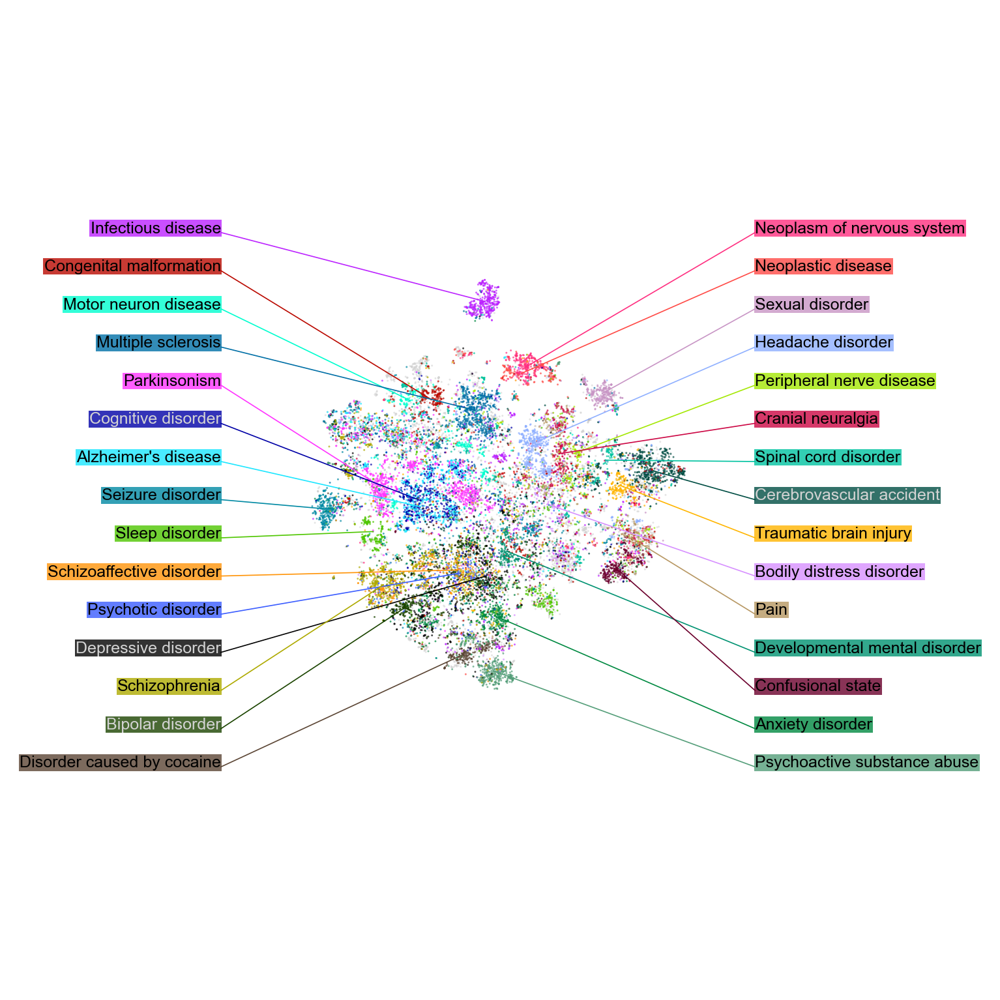

In [236]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")

txtkwargs = dict(size=8, weight="bold", va="top", ha="left")
x_lim = (-180, 180)
y_lim = (-180, 180)

plot_tsne_colors(
    tsne, colors_new, x_lim=x_lim, y_lim=y_lim, ax=ax, plot_type="test"
)
plot_label_tags(
    tsne,
    colors_new,
    colors_new_legend,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    fontsize=6,
    rs=2,
    subset=False,
)

fig.savefig(
    figures_path / f"tsne_colored_by_condition_labels_{len(tsne)}.pdf", dpi=300
)

### Interactive Plot

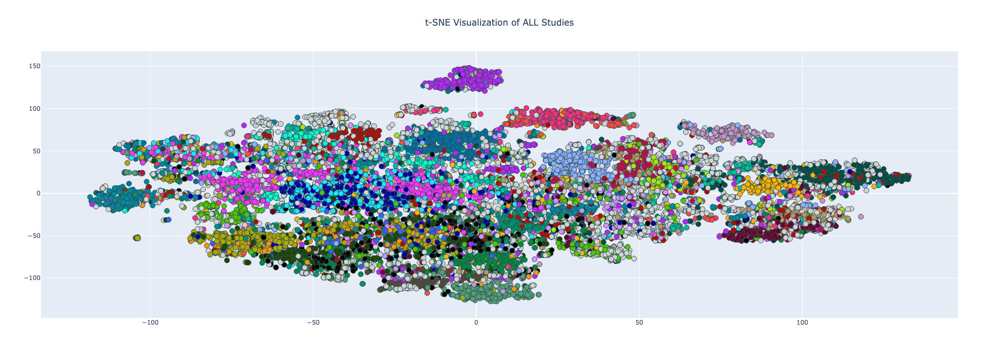

In [237]:
import plotly.graph_objects as go

# Assuming your t-SNE data is stored in a variable named `tsne`
# And your DataFrame `df` contains a column 'study_official_title' for the official titles

fig = go.Figure()

# Add scatter plot for t-SNE data points
fig.add_trace(
    go.Scatter(
        x=tsne[:, 0],  # Use your t-SNE x coordinates
        y=tsne[:, 1],  # Use your t-SNE y coordinates
        mode="markers",
        marker=dict(
            color=colors_new,  # "RoyalBlue",  # Use a single color for all points
            size=10,  # Adjust the marker size here
            line=dict(width=1, color="DarkSlateGrey"),
        ),
        text=[
            f"<b>{nctid}:</b> {title}"
            for nctid, title in zip(df["nct_id"], df["study_official_title"])
        ],  # Combine NCT ID and title for hover text
        hovertemplate="%{text}<extra></extra>",
        showlegend=False,  # Hide the legend for data points
    )
)

# Update plot size here
fig.update_layout(
    title="t-SNE Visualization of ALL Studies",
    title_x=0.5,
    width=900,  # Set the width of the plot
    height=700,  # Set the height of the plot
)
# Show the figure
fig.show()

In [238]:
# Filter the DataFrame to keep only rows where "cluster" is "unlabeled"
unlabeled_df = df[df["cluster"] == "unlabeled"]

# Get the indices of the filtered DataFrame
unlabeled_indices = unlabeled_df.index

# Use the indices to filter the t-SNE coordinates
unlabeled_tsne = tsne[unlabeled_indices, :]

In [239]:
unlabeled_tsne.shape

(3603, 2)

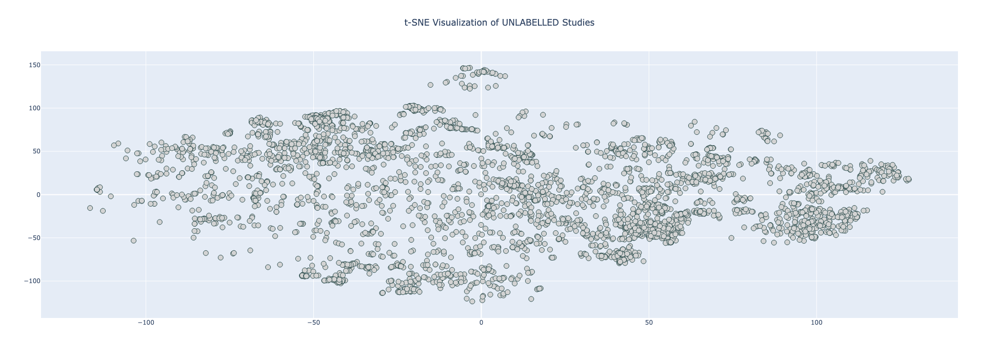

In [240]:
import plotly.graph_objects as go

# Assuming your t-SNE data is stored in a variable named `tsne`
# And your DataFrame `df` contains a column 'study_official_title' for the official titles

fig = go.Figure()

# Add scatter plot for t-SNE data points
fig.add_trace(
    go.Scatter(
        x=unlabeled_tsne[:, 0],  # Use your t-SNE x coordinates
        y=unlabeled_tsne[:, 1],  # Use your t-SNE y coordinates
        mode="markers",
        marker=dict(
            color="LightGrey",  # Use a single color for all points
            size=10,  # Adjust the marker size here
            line=dict(width=1, color="DarkSlateGrey"),
        ),
        hovertemplate="<b>Title:</b> %{text}",
        text=unlabeled_df[
            "study_official_title"
        ],  # Make sure this points to the column with your official titles
        showlegend=False,  # Hide the legend for data points
    )
)

# Update plot size here
fig.update_layout(
    title="t-SNE Visualization of UNLABELLED Studies",
    title_x=0.5,
    width=900,  # Set the width of the plot
    height=700,  # Set the height of the plot
)
# Show the figure
fig.show()

## Drugs

In [316]:
top_30_drug_names = [
    "Risperidone",
    "Levodopa",
    "Anti-psychotic agent",
    "Ketamine",
    "Olanzapine",
    "Aripiprazole",
    "Carbidopa",
    "Dexmedetomidine",
    "Quetiapine",
    "Donepezil",
    "Nicotine",
    "serotonin re-uptake inhibitor",
    "Clostridium botulinum toxin",
    "Botulinum toxin type A",
    "Propofol",
    "Lidocaine",
    "Escitalopram",
    "Pregabalin",
    "Memantine",
    "Nicotine resin complex",
    "Levetiracetam",
    "Bupropion",
    "Cannabidiol",
    "Valproic acid",
    "Topiramate",
    "Melatonin",
    "Aspirin",
    "Oxytocin",
    "Lithium",
    "N-3 fatty acid",
    "vaccine",
]

In [317]:
colors_new_legend = dict(zip(top_30_drug_names, chosen_colors))
len(colors_new_legend)

31

In [318]:
df

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,start_year,trial_title_summary,cluster
0,89,NCT00000307,Naltrexone (substance),Disorder caused by alcohol (disorder)|Disorder...,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,2003-04-30,Naltrexone as an Adjunct in Alcoholic Cocaine ...,The purpose of this study is to evaluate naltr...,2003.0,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,unlabeled
1,106,NCT00000333,Atropine (substance)|Benzatropine (substance)|...,Cocaine|Disorder caused by cocaine (disorder),Evaluation of Benztropine for Cocaine Craving - 2,2001-05-31,Evaluation of Efficacy of Benztropine for Coca...,The purpose of this study is to compare the ef...,2001.0,Evaluation of Benztropine for Cocaine Craving ...,unlabeled
2,145,NCT00000428,Amitriptyline (substance)|Fluoxetine (substanc...,Fibromyalgia (disorder),Combining N-of-1 Trials to Assess Fibromyalgia...,2000-09-30,Combining N-of-1 Trials to Assess Fibromyalgia...,This study will compare the effectiveness of c...,2000.0,Combining N-of-1 Trials to Assess Fibromyalgia...,unlabeled
3,146,NCT00000439,Sodium valproate (substance)|Valproate (substa...,Bipolar disorder (disorder)|Disorder caused by...,Drug Treatment for Alcoholics With Bipolar Dis...,2000-10-31,Efficacy of Valproate Maintenance in Bipolar A...,The purpose of this study is to test the effec...,2000.0,Drug Treatment for Alcoholics With Bipolar Dis...,Valproic acid
4,220,NCT00001956,Ketorolac (substance)|Lidocaine (substance)|Mi...,Central pain syndrome (disorder)|Disorder of m...,Influence of Genetics in Pain Sensitivity,2000-01-31,NaN,The purpose of this study is to learn more abo...,2000.0,Influence of Genetics in Pain Sensitivity | |...,Lidocaine
...,...,...,...,...,...,...,...,...,...,...,...
18604,19606,NCT06282640,Blood group antigen V (substance)|Ergocalcifer...,Cts|Median neuropathy (disorder)|Pain|Peripher...,Comparıson Of Electromyography Results Before ...,2021-12-30,Comparıson Of Electromyography Results Before ...,"Therefore, we aimed to evaluate the effectiven...",2021.0,Comparıson Of Electromyography Results Before ...,unlabeled
18605,19613,NCT06287502,2-methyl-3-hydroxybutyrate (substance),Degenerative disorder of muscle (disorder)|Ost...,Efficacy of Structured Exercise-Nutritional In...,2022-09-09,Efficacy of Structured Exercise-Nutritional In...,"This is a prospective parallel group, double-b...",2022.0,Efficacy of Structured Exercise-Nutritional In...,unlabeled
18606,19616,NCT06289335,Dexmedetomidine (substance)|Ondansetron (subst...,Complication of surgical procedure (disorder)|...,Dexmedetomidine Compared to Ondansetron for Po...,2020-08-05,Dexmedetomidine Compared With Ondansetron in T...,Evaluate the efficiency of management with int...,2020.0,Dexmedetomidine Compared to Ondansetron for Po...,Dexmedetomidine
18607,19623,NCT06292351,"Dimetan (substance)|N-methyl-1-(1,3-benzodioxo...",Alzheimer's disease (disorder)|Dementia (disor...,DMB-I in the Treatment of Alzheimer Type Dementia,2023-12-27,Multicenter Randomized Double-blind Placebo-co...,The purpose of this study is to assess the eff...,2023.0,DMB-I in the Treatment of Alzheimer Type Demen...,unlabeled


In [319]:
%%time
labels_new, colors_new = improved_coloring(
    df["combined_union_snomed_term_canonical_interventions"],
    colors_new_legend,
)

df["cluster"] = labels_new

CPU times: user 262 ms, sys: 7.47 ms, total: 269 ms
Wall time: 272 ms


In [320]:
cluster_sizes = df["cluster"].value_counts()

# Optionally, to convert it back to a DataFrame for better visualization or further processing:
cluster_sizes_df = cluster_sizes.reset_index().rename(
    columns={"index": "Cluster", "cluster": "Size"}
)

print(cluster_sizes_df)

                             Size  count
0                       unlabeled  14072
1                       Carbidopa    233
2                        Ketamine    217
3                    Aripiprazole    208
4                      Quetiapine    195
5                      Olanzapine    182
6                         vaccine    176
7                        Levodopa    176
8                 Dexmedetomidine    174
9                     Risperidone    170
10                      Lidocaine    165
11                      Donepezil    163
12    Clostridium botulinum toxin    160
13                   Escitalopram    146
14                       Propofol    146
15                     Pregabalin    144
16           Anti-psychotic agent    143
17                      Memantine    141
18                        Lithium    141
19                      Bupropion    138
20                    Cannabidiol    131
21                        Aspirin    128
22                      Melatonin    126
23              

no cluster for  Botulinum toxin type A


/Users/sdoneva/Documents/Work/In Progress/PhD/PhD Projects/In Progress/NeuroTrialAnalysis/src/plotting.py:442: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/Users/sdoneva/Documents/Work/In Progress/PhD/PhD Projects/In Progress/NeuroTrialAnalysis/src/plotting.py:438: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/Users/sdoneva/Documents/Work/In Progress/PhD/PhD Projects/In Progress/NeuroTrialAnalysis/src/plotting.py:458: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value

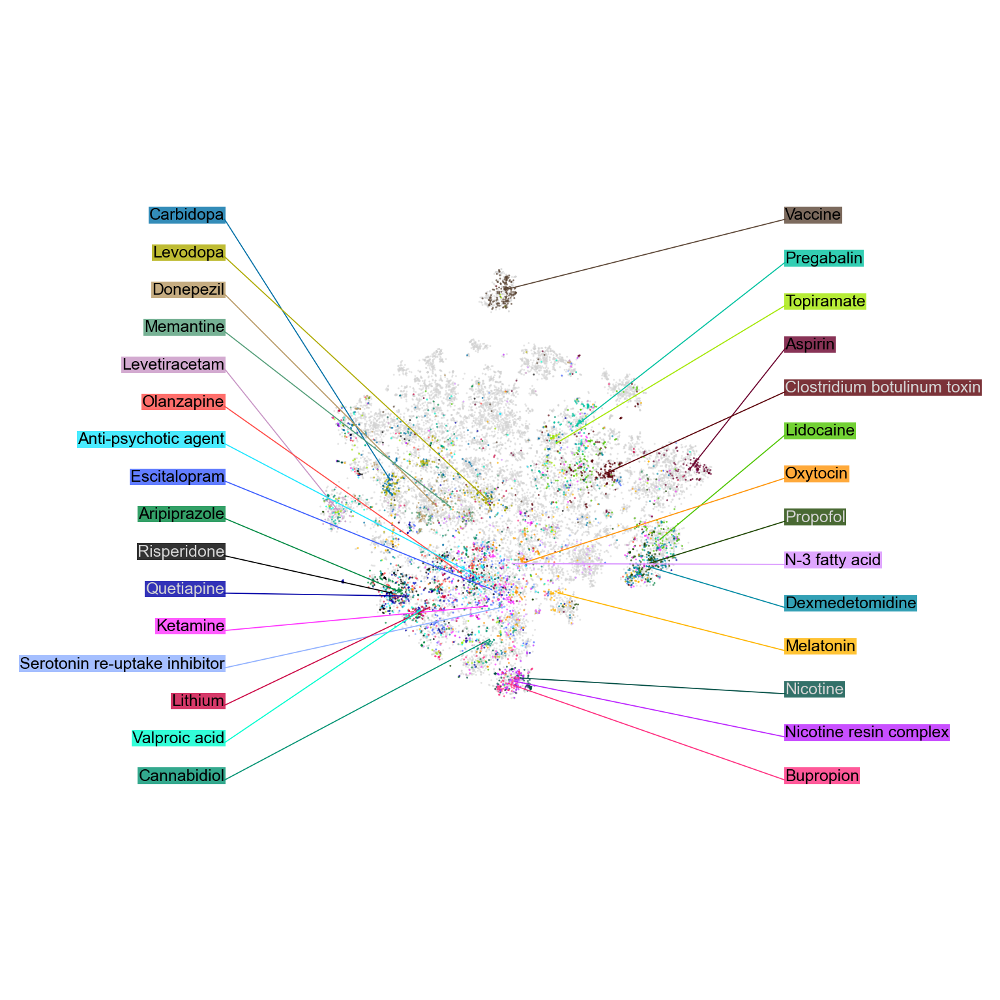

In [321]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")

txtkwargs = dict(size=8, weight="bold", va="top", ha="left")
x_lim = (-180, 180)
y_lim = (-180, 180)

plot_tsne_colors(
    tsne, colors_new, x_lim=x_lim, y_lim=y_lim, ax=ax, plot_type="test"
)
plot_label_tags(
    tsne,
    colors_new,
    colors_new_legend,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    fontsize=6,
    rs=2,
    subset=False,
)

fig.savefig(
    figures_path / f"tsne_colored_by_drug_labels_{len(tsne)}.pdf", dpi=300
)

In [306]:
# Filter the DataFrame to keep only rows where "cluster" is "unlabeled"
unlabeled_df = df[df["cluster"] == "unlabeled"]

# Get the indices of the filtered DataFrame
unlabeled_indices = unlabeled_df.index

# Use the indices to filter the t-SNE coordinates
unlabeled_tsne = tsne[unlabeled_indices, :]

unlabeled_tsne.shape

(14349, 2)

In [307]:
counts = unlabeled_df[intervention_col].value_counts()
counts = counts.sort_values(ascending=False).head(30)
counts

combined_union_snomed_term_canonical_interventions
Human mesenchymal stem cell (substance)                                                                    81
Varenicline (substance)                                                                                    71
Acetylcysteine (substance)                                                                                 59
Antidepressant (substance)                                                                                 56
Sertraline (substance)                                                                                     47
Ribavirin (substance)                                                                                      38
Paliperidone (substance)|Paliperidone palmitate (substance)                                                38
Latamoxef disodium (substance)                                                                             38
Lamotrigine (substance)                                              

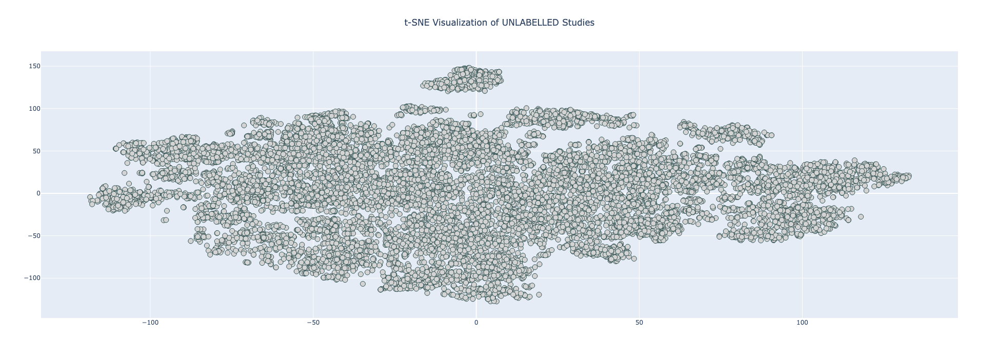

In [308]:
import plotly.graph_objects as go

# Assuming your t-SNE data is stored in a variable named `tsne`
# And your DataFrame `df` contains a column 'study_official_title' for the official titles

fig = go.Figure()

# Add scatter plot for t-SNE data points
fig.add_trace(
    go.Scatter(
        x=unlabeled_tsne[:, 0],  # Use your t-SNE x coordinates
        y=unlabeled_tsne[:, 1],  # Use your t-SNE y coordinates
        mode="markers",
        marker=dict(
            color="LightGrey",  # Use a single color for all points
            size=10,  # Adjust the marker size here
            line=dict(width=1, color="DarkSlateGrey"),
        ),
        hovertemplate="<b>Title:</b> %{text}",
        text=unlabeled_df[
            "study_official_title"
        ],  # Make sure this points to the column with your official titles
        showlegend=False,  # Hide the legend for data points
    )
)

# Update plot size here
fig.update_layout(
    title="t-SNE Visualization of UNLABELLED Studies",
    title_x=0.5,
    width=900,  # Set the width of the plot
    height=700,  # Set the height of the plot
)
# Show the figure
fig.show()

## Colors by Year

In [117]:
aact_data_years = df[["nct_id", "start_date"]].drop_duplicates()
aact_data_years["start_date"] = pd.to_datetime(aact_data_years["start_date"])
# Extract year component and create new columns
aact_data_years["start_year"] = aact_data_years["start_date"].dt.year
aact_data_years

,nct_id,start_date,start_year
0,NCT00000307,2003-04-30,2003
1,NCT00000333,2001-05-31,2001
2,NCT00000428,2000-09-30,2000
3,NCT00000439,2000-10-31,2000
4,NCT00001956,2000-01-31,2000
...,...,...,...
18604,NCT06282640,2021-12-30,2021
18605,NCT06287502,2022-09-09,2022
18606,NCT06289335,2020-08-05,2020
18607,NCT06292351,2023-12-27,2023


In [118]:
years = list(set(aact_data_years["start_year"].dropna()))
years

[2000,
 2001,
 2002,
 2003,
 2004,
 2005,
 2006,
 2007,
 2008,
 2009,
 2010,
 2011,
 2012,
 2013,
 2014,
 2015,
 2016,
 2017,
 2018,
 2019,
 2020,
 2021,
 2022,
 2023]

In [119]:
min(years)

2000

In [120]:
min_year = min(years)  # 1970
length_interval = 2022 - min_year
cmap_values = np.linspace(0, 1, length_interval + 1)
year_numbers_list = np.arange(min_year, 2023).tolist()

dicc_years = dict(zip(year_numbers_list, cmap_values))

In [121]:
years_out = [year for year in range(1808, min_year)] + [
    year for year in range(2024, 2100)
]

for elem in years_out:
    dicc_years[elem] = 0

In [122]:
aact_data_years.shape

(18609, 3)

In [123]:
dates = aact_data_years["start_year"].astype(str)
dic = dicc_years

N = len(years)

dict_colors = {}

date_year = np.zeros(len(dates))

for i in range(N):
    sub1 = str(years[i])
    # print(sub1)
    indexes1 = dates.str.find(sub1)

    non_1_1 = indexes1[indexes1 != -1]

    date_year[indexes1 != -1] = int(years[i])

# create colors
date_colors = np.vectorize(dic.get)(date_year)

In [124]:
colors_per_year_reparsed = date_colors

In [125]:
len(colors_per_year_reparsed)

18609

In [126]:
np.save(variables_path / "colors_per_year_reparsed", colors_per_year_reparsed)
np.save(variables_path / "date_year_reparsed", date_year)

### Plot

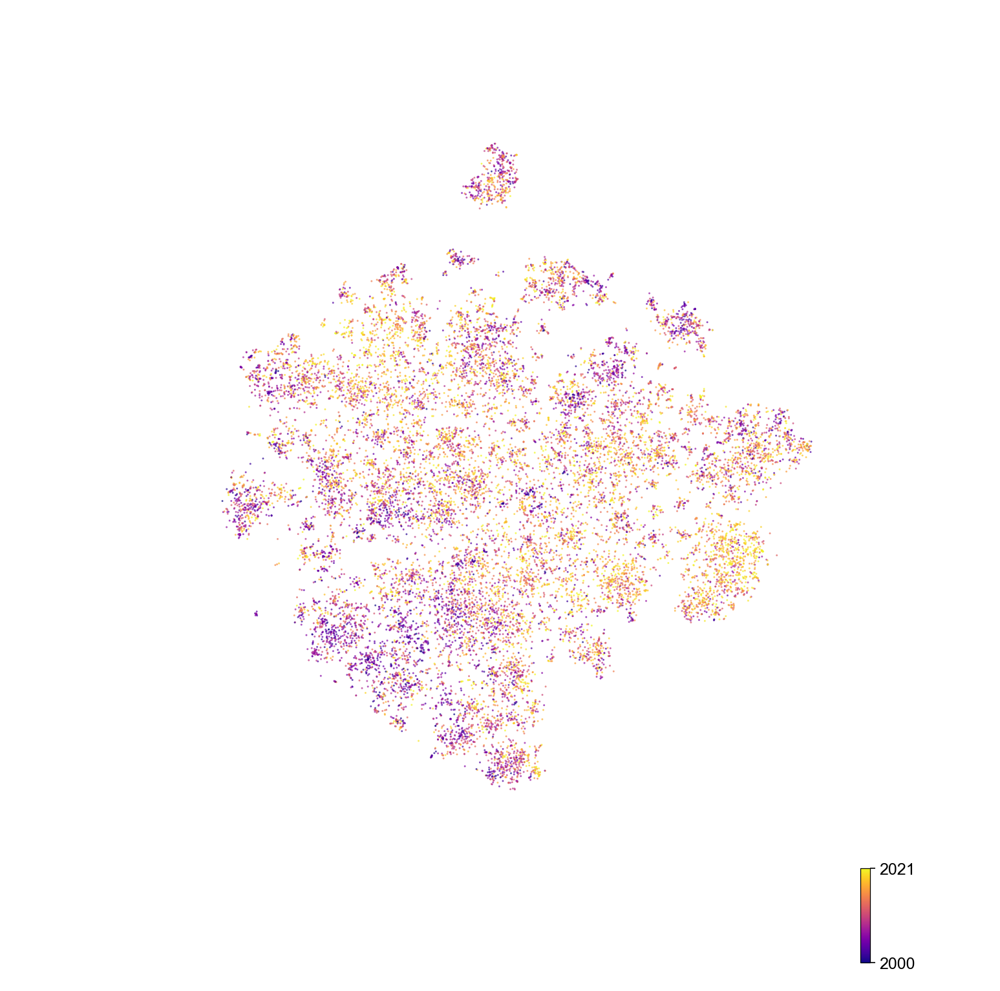

In [127]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")

txtkwargs = dict(size=8, weight="bold", va="top", ha="left")
x_lim = (-230, 230)
y_lim = (-230, 230)

plot_tsne_years(
    tsne,
    colors_per_year_reparsed,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    fontsize=6,
    colorbar=True,
    plot_type="test",
    min_year=min_year,
)

## Colors by Phase

In [183]:
aact_data = pd.read_csv(
    "data/raw_aact/combined_neuro_trials_with_interventions_20240412.csv"
)
aact_data_phase = aact_data[["nct_id", "phase"]].drop_duplicates()
aact_data_phase

,nct_id,phase
0,NCT03651726,Phase 2
5,NCT02326883,Not Applicable
14,NCT05262348,Not Applicable
20,NCT01550107,Phase 4
26,NCT04375436,Phase 1
...,...,...
503980,NCT02422303,Not Applicable
503983,NCT02714049,Phase 4
503987,NCT04408573,Not Applicable
503990,NCT03869463,Not Applicable


In [184]:
df_with_phase = df.merge(aact_data_phase, on="nct_id", how="left")
df_phases = df_with_phase[["phase"]]

In [185]:
df_phases.shape

(18609, 1)

In [186]:
cluster_sizes = df_with_phase["phase"].value_counts()
cluster_sizes

phase
Phase 2            4378
Not Applicable     3394
Phase 3            3344
Phase 4            3130
Phase 1            2352
Phase 1/Phase 2     904
Phase 2/Phase 3     693
Early Phase 1       414
Name: count, dtype: int64

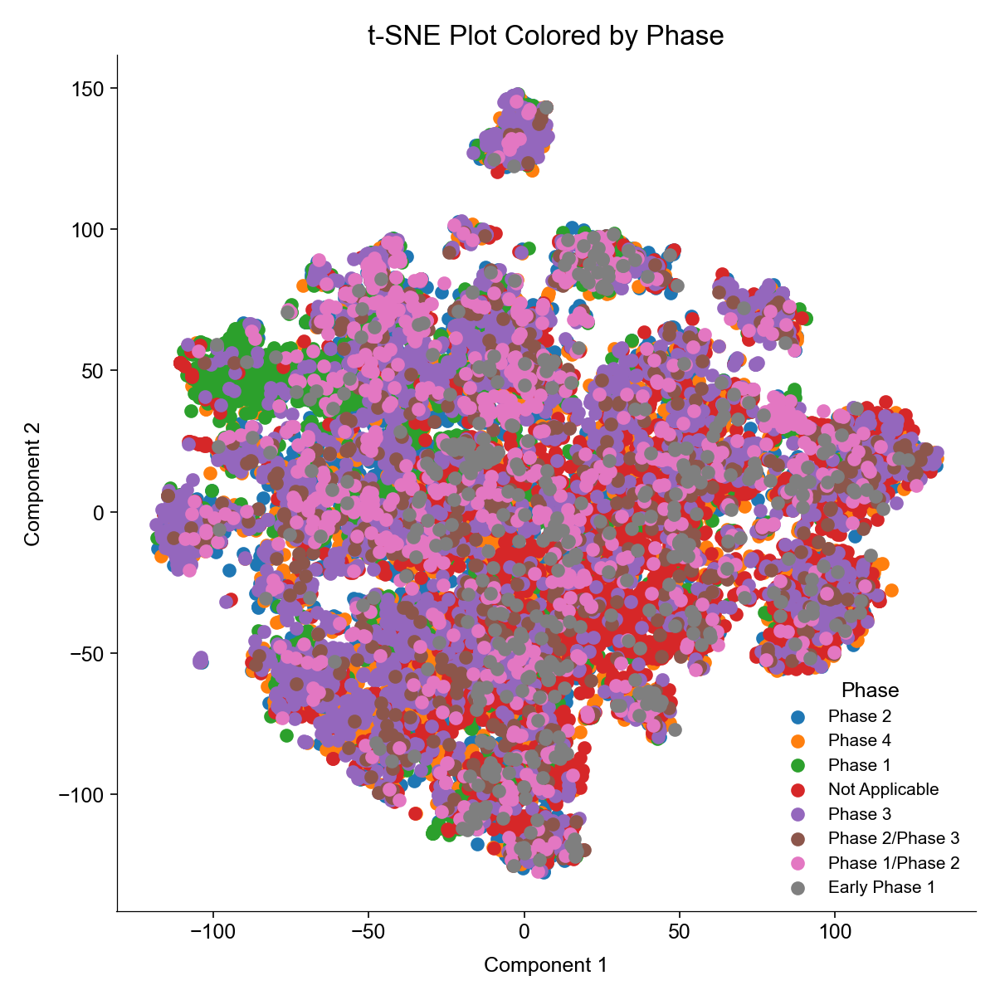

In [201]:
df_tsne = pd.DataFrame(tsne, columns=["x", "y"])

# Ensure the DataFrame with your phase data is aligned in row order with your t-SNE data
# Assuming it is already correctly aligned and has the same index

# Concatenate the t-SNE DataFrame with the phase DataFrame along the axis 1 (columns)
df_tsne_phase = pd.concat([df_tsne, df_phases], axis=1)

# Plot using matplotlib, coloring by phase
plt.figure(figsize=(4, 4))
for phase in df_tsne_phase["phase"].unique():
    subset = df_tsne_phase[df_tsne_phase["phase"] == phase]
    plt.scatter(subset["x"], subset["y"], label=phase)

plt.title("t-SNE Plot Colored by Phase")
plt.xlabel("Component 1")
plt.ylabel("Component 2")
plt.legend(title="Phase")
plt.tight_layout()

plt.savefig(figures_path / "tsne_colored_by_phase.pdf", dpi=300)
plt.savefig(figures_path / "tsne_colored_by_phase.png", dpi=300)

plt.show()